# Pokemon

Dataset from https://www.kaggle.com/datasets/djilax/pkmn-image-dataset

Idea based on HuggingFace diffusers https://github.com/huggingface/diffusers/tree/main/examples

In [ ]:
using Images
using Plots
using ProgressMeter
using StatsBase
using BSON, JSON
using Flux
using Random
using Printf
using ProgressMeter

In [ ]:
using Revise
using DenoisingDiffusion 
using DenoisingDiffusion: train!, split_validation

In [ ]:
include("../utilities.jl");

## Load

In [ ]:
data_directory="C:\\Users\\sinai\\Documents\\Projects\\datasets\\Pokemon\\";

In [ ]:
data = BSON.load(joinpath(data_directory, "imgs_WHCN_48x48.bson"))[:imgs_WHCN];
size(data)

(48, 48, 3, 7356)

In [ ]:
norm_data = normalize_neg_one_to_one(data);

In [ ]:
train_x, val_test_x = split_validation(MersenneTwister(2714), norm_data);
n_val = floor(Int, size(val_test_x, 4)/2)
n_train = size(train_x, 4)
val_x = val_test_x[:, :, :, 1:n_val]
test_x = val_test_x[:, :, :, (n_val + 1):end]

println("train_x: ", size(train_x))
println("val_x:   ", size(val_x))
println("test_x:  ", size(test_x))

train_x: (48, 48, 3, 6621)
val_x:   (48, 48, 3, 367)
test_x:  (48, 48, 3, 368)


## Data exploration

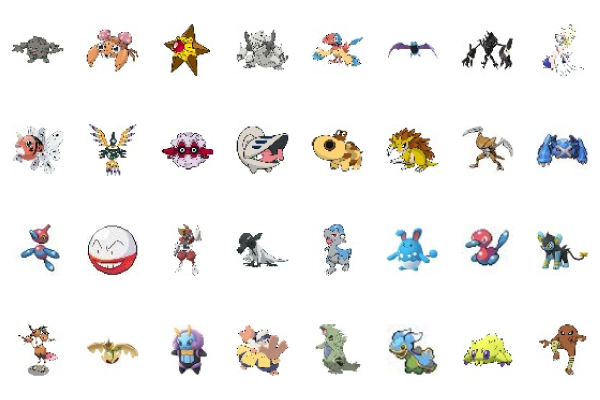

In [ ]:
nrows = 4
ncols = 8
canvases = []
for row in 1:nrows
    for col in 1:ncols
        idx = rand(1:n_train)
        img_WHC = train_x[:, :, :, idx]
        img_WHC = normalize_zero_to_one(img_WHC)
        img = img_WHC_to_rgb(img_WHC)
        push!(canvases, plot(img))
    end
end
plot(canvases..., layout=(nrows, ncols), ticks=nothing, showaxis=:off)

## Diffusion

In [ ]:
num_timesteps = 100
#βs = linear_beta_schedule(num_timesteps, 0.0001, 0.002) 
βs = cosine_beta_schedule(num_timesteps, 0.008)
diffusion = GaussianDiffusion(Vector{Float32}, βs, (48, 48, 3, ), identity)

GaussianDiffusion{Vector{Float32}}(num_timesteps=100, data_shape=(48, 48, 3), denoise_fn=identity, buffers_size=5.156 KiB)

In [ ]:
# idx = rand(1:n_train)
# img_WHC = train_x[:, :, :, idx][:, :, :, 1];
img_WHC = normalize_neg_one_to_one(data[:, :, :, 13]);

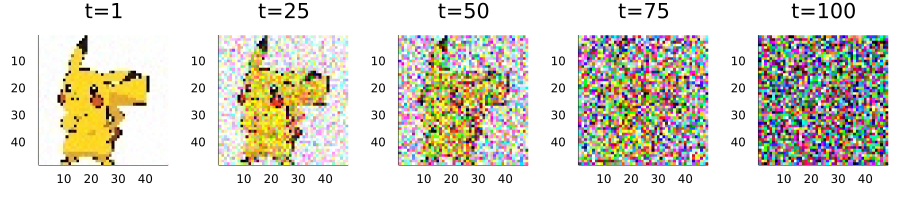

In [ ]:
canvases = []
for frac in [0.0, 0.25, 0.5, 0.75, 1]
    local p
    timestep = max(1, ceil(Int, frac * num_timesteps))
    Xt = q_sample(diffusion, img_WHC, timestep)
    clamp!(Xt, -one(Xt[1]), one(Xt[1]))
    Xt = normalize_zero_to_one(Xt)
    img = img_WHC_to_rgb(Xt)
    p = plot(img, title="t=$timestep")
    push!(canvases, p)
end

p = plot(canvases..., layout=(1, 5), link=:both, size=(900, 200))
#savefig("../outputs/pokemon_forward_mewtwo.png")
p

In [ ]:
XT = q_sample(diffusion, img_WHC, num_timesteps)
anim_forward = @animate for t ∈ 1:1:(num_timesteps + 20)
    if t < num_timesteps
        Xt = q_sample(diffusion, img_WHC, t)
    else
        Xt = XT
        t = num_timesteps
    end
    clamp!(Xt, -one(Xt[1]), one(Xt[1]))
    Xt = normalize_zero_to_one(Xt)
    img = img_WHC_to_rgb(Xt)
    p = plot(img, title="t=$t")
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_kRgWRx", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000111.png", "000112.png", "000113.png", "000114.png", "000115.png", "000116.png", "000117.png", "000118.png", "000119.png", "000120.png"])

┌ Info: Saved animation to 
│   fn = C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\outputs\pokemon_forward.gif
└ @ Plots C:\Users\sinai\.julia\packages\Plots\1KWPG\src\animation.jl:114


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\outputs\\pokemon_forward.gif")
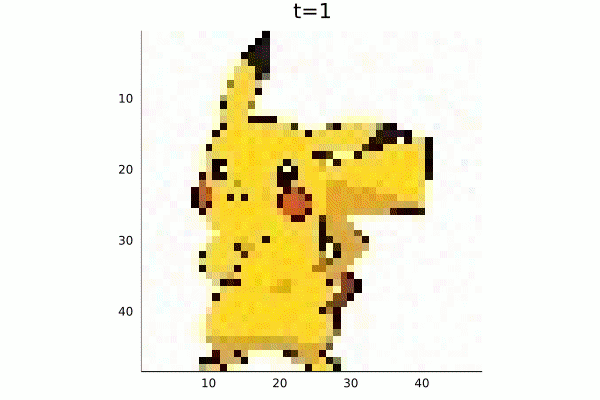

In [ ]:
gif(anim_forward, "../outputs/pokemon_forward.gif", fps=15)

## Test

In [ ]:
directory = "../models/Pokemon_20221022_1727";
diffusion_path = joinpath(directory, "diffusion_epoch=10.bson");
history_path = joinpath(directory, "history.json");

In [ ]:
diffusion = BSON.load(diffusion_path)[:diffusion]
println("data shape:    $(diffusion.data_shape)")
num_timesteps = diffusion.num_timesteps
println("num timesteps: $(num_timesteps)")
diffusion.denoise_fn

data shape:    (48, 48, 3)
num timesteps: 100


UNet(
  time_embedding = Chain(
    SinusoidalPositionEmbedding(100 => 64),
    Dense(64 => 64, gelu),              # 4_160 parameters
    Dense(64 => 64),                    # 4_160 parameters
  ),
  chain = ConditionalChain(
    init = Conv((3, 3), 3 => 16, pad=1),  # 448 parameters
    down_1 = ResBlock(
      in_layers = ConvEmbed(
        embed_layers = Chain(
          NNlib.swish,
          Dense(64 => 16),              # 1_040 parameters
        ),
        conv = Conv((3, 3), 16 => 16, pad=1),  # 2_320 parameters
        norm = GroupNorm(16, 8),        # 32 parameters
        activation = NNlib.swish,
      ),
      out_layers = Chain(
        Conv((3, 3), 16 => 16, pad=1),  # 2_320 parameters
        GroupNorm(16, 8),               # 32 parameters
        NNlib.swish,
      ),
      skip_transform = identity,
    ),
    skip_1 = ConditionalSkipConnection(
      ConditionalChain(
        downsample_1 = Conv((4, 4), 16 => 16, pad=1, stride=2),  # 4_112 parameters
        down_2 

In [ ]:
history = Dict()
open(history_path, "r") do f
    global history
    history=JSON.parse(read(f, String))
end

Dict{String, Any} with 3 entries:
  "train_loss" => Any[0.808022, 0.227503, 0.176094, 0.149845, 0.137713, 0.12447…
  "epoch_size" => 6621
  "val_loss"   => Any[0.277166, 0.219794, 0.168566, 0.147373, 0.133069, 0.12858…

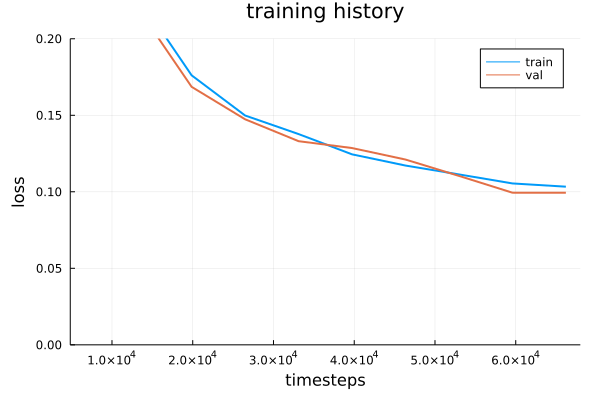

In [ ]:
timesteps = (1:length(history["train_loss"])) * history["epoch_size"]

p = plot(timesteps, history["train_loss"], 
    label="train", ylims=(0, 0.2),
    title="training history",
    xlabel="timesteps",
    ylabel="loss",
    linewidth=2,
    #markershape=:circle,
)
plot!(p, timesteps, history["val_loss"], label="val", linewidth=2, margin=3Plots.mm)
savefig(p, joinpath(directory, "loss.png"))
p

## validate

In [ ]:
val_data = Flux.DataLoader(val_x; batchsize=32, shuffle=false);

In [ ]:
val_loss = 0.0
@showprogress for x in val_data
    global val_loss
    val_loss += p_losses(diffusion, Flux.mse, x)
end
val_loss /= length(val_data)
@printf("\nval loss: %.5f\n", val_loss)

Progress: 100%|█████████████████████████████████████████| Time: 0:00:24



val loss: 0.10409


### Sample

In [ ]:
X0s, X0_ests = p_sample_loop_all(diffusion, 16; to_device=cpu) ;
size(X0s)

Sampling... 100%|████████████████████████████████████████| Time: 0:00:58


(48, 48, 3, 16, 100)

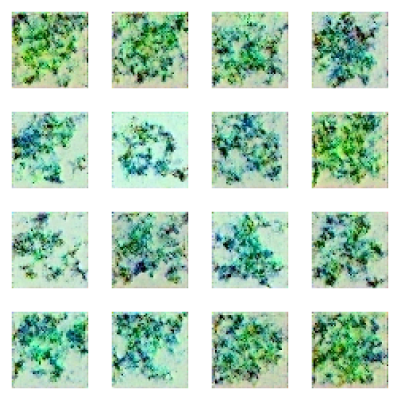

In [ ]:
num_images = size(X0s, 4)
imgs = X0s[:, :, :, :, end] |> normalize_zero_to_one |> img_WHC_to_rgb
p = plot([plot(imgs[:, :, i]) for i in 1:num_images]..., showaxis=:off, ticks=:none, size=(400, 400))
savefig(p, joinpath(directory, "samples_epoch=10.png"))
p

In [ ]:
anim_denoise = @animate for t ∈ 1:(num_timesteps + 15)
    t = t > num_timesteps ? num_timesteps : t
    imgs = X0s[:, :, :, :, t] |> normalize_zero_to_one |> img_WHC_to_rgb
    p = plot(
        [plot(imgs[:, :, i]) for i in 1:num_images]..., 
        showaxis=:off, 
        ticks=:none, 
        size=(400, 400),
        plot_title="$t",
    )
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_ELv7h7", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000106.png", "000107.png", "000108.png", "000109.png", "000110.png", "000111.png", "000112.png", "000113.png", "000114.png", "000115.png"])

┌ Info: Saved animation to 
│   fn = C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\models\Pokemon_20221022_1727\reverse_pokemon.gif
└ @ Plots C:\Users\sinai\.julia\packages\Plots\1KWPG\src\animation.jl:114


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\models\\Pokemon_20221022_1727\\reverse_pokemon.gif")
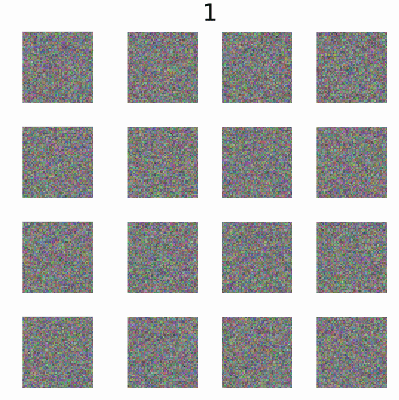

In [ ]:
gif(anim_denoise, joinpath(directory, "reverse_pokemon.gif"), fps=15)

In [ ]:
anim_estimates = @animate for t ∈ 1:(num_timesteps + 15)
    t = t > num_timesteps ? num_timesteps : t
    imgs = X0_ests[:, :, :, :, t] |> normalize_zero_to_one |> img_WHC_to_rgb
    p = plot(
        [plot(imgs[:, :, i]) for i in 1:num_images]..., 
        showaxis=:off, 
        ticks=:none, 
        size=(400, 400),
        plot_title="$t",
    )
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_Gmbbdc", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000106.png", "000107.png", "000108.png", "000109.png", "000110.png", "000111.png", "000112.png", "000113.png", "000114.png", "000115.png"])

┌ Info: Saved animation to 
│   fn = C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\models\Pokemon_20221022_1727\estimates_pokemon.gif
└ @ Plots C:\Users\sinai\.julia\packages\Plots\1KWPG\src\animation.jl:114


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\models\\Pokemon_20221022_1727\\estimates_pokemon.gif")
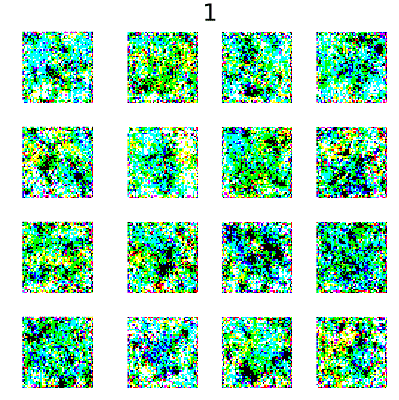

In [ ]:
gif(anim_estimates, joinpath(directory, "estimates_pokemon.gif"), fps=15)